In [1]:
from pathlib import Path
import os
import pandas as pd
import sys
import requests
from functools import partial
from tqdm import tqdm
from collections import defaultdict

import torch
import torchvision
from torchvision.io import read_image
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch 
from einops import rearrange, repeat
from loguru import logger
from torchmetrics import Metric, BootStrapper
import matplotlib.pyplot as plt
from PIL import Image
import pickle
import seaborn as sns
from matplotlib.pyplot import figure
from cka import gram, centering_mat, centered_gram, unbiased_hsic_xy, MinibatchCKA, HookedCache, make_pairwise_metrics, update_metrics, get_simmat_from_metrics
import numpy as np
import re

os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

import timm
from timm.utils import accuracy
from torch.utils.tensorboard import SummaryWriter

from get_models import get_model
from knn_probe import extract_features

writer = SummaryWriter()

DEVICE = torch.device('cpu')
if torch.cuda.is_available():
  DEVICE = torch.device('cuda')

import matplotlib.pyplot as plt
from matplotlib import ticker

%matplotlib inline

/private/home/sshkhr/.conda/envs/pytorch_env/lib/python3.9/site-packages/torchvision/transforms/transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


Data loaded with 1281167 train and 50000 val imgs.


### Create ImageNet validation dataset

In [2]:
# using the validation transforms
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            normalize,
        ])

## Randomly subsample features too

data_path='/datasets01/imagenet_full_size/061417/'
dataset = torchvision.datasets.ImageFolder(data_path + 'val', transform=transform)

In [3]:
test_labels = [s[-1] for s in dataset.samples]

In [4]:
len(test_labels)

50000

In [5]:
classes = [i for i in range(50, 1000, 100)]

In [6]:
indexes = [ind for ind, cls in enumerate(test_labels) if cls in classes]

In [7]:
len(indexes)

500

## Get tSNE

In [8]:
names = ['MoCo-V3', 'DINO', 'MAE']
modes = ['linear', 'finetuned']
aggs = ['CLS_feats']
layers = ['blocks.' + str(i) for i in range(12)]

In [9]:
tsne_all_results = defaultdict(lambda: defaultdict(dict))

In [10]:
for name in names:
    for mode in modes:
        for agg in aggs:
            for layer in layers:
                file_name = 'tsne_results/' + name + '/' + mode + '/' + agg + '_' + layer + "_" + "tsne.pkl"
                if not os.path.isfile(file_name):
                    print(name, mode, agg, layer)
                    continue 
                with open(file_name, 'rb') as pickle_file:
                    tsne_results = pickle.load(pickle_file)
                    tsne_all_results[name][mode][layer] = tsne_results


In [11]:
def tSNE_plot_all_blocks(tsne_results, test_labels, name, mode, agg):

    file_name = '../figures/tsne/' + name + '/' + mode + '-2.png'

    if not os.path.exists(os.path.dirname(file_name)):
        os.makedirs(os.path.dirname(file_name))

    fig, ax = plt.subplots(3, 4, figsize=(20, 16), dpi=300, sharex=True)

    for i in range(12):
        x = int(i/4)
        y = i%4

        try:
            layer_results = tsne_results[name][mode]['blocks.' + str(i)]
        except KeyError:
            continue
        
        a = [layer_results[i, 0] for i in indexes]
        b = [layer_results[i, 1] for i in indexes]
        sns.scatterplot(
            x=a, y=b,
            hue=[test_labels[i] for i in indexes],
            palette=sns.color_palette("hls", 10),
            legend=False,
            alpha=0.3,
            ax=ax[x][y]
        )
        
        #ax[x][y].set_xlabel("Fine-tuning Epochs")
        ax[x][y].set_ylabel('blocks.' + str(i))
        #handles, labels = ax[x][y].get_legend_handles_labels()
        #ax[x][y].get_legend().remove()    

    fig.subplots_adjust(bottom=0.1, wspace=0.1)

    #fig.legend(handles = handles, labels=labels, loc='lower center', 
    #         bbox_to_anchor=(0.5, -0.03),fancybox=False, shadow=False, ncol=3, prop={'size': 14})

    fig.suptitle('2D tSNE embedding of ' + name + ' ' + mode + ' ' + agg, fontsize=20,  y=1.01)

    plt.tight_layout()
    plt.show()

    fig.savefig(file_name, dpi=300, bbox_inches = "tight")

    return fig

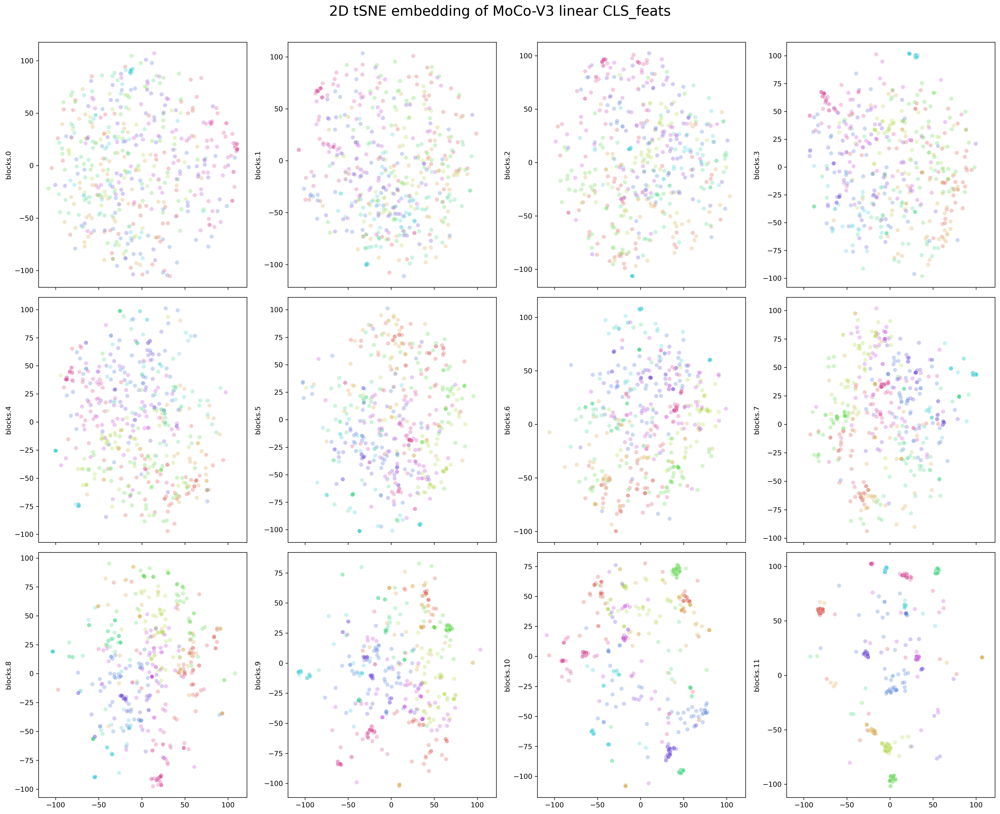

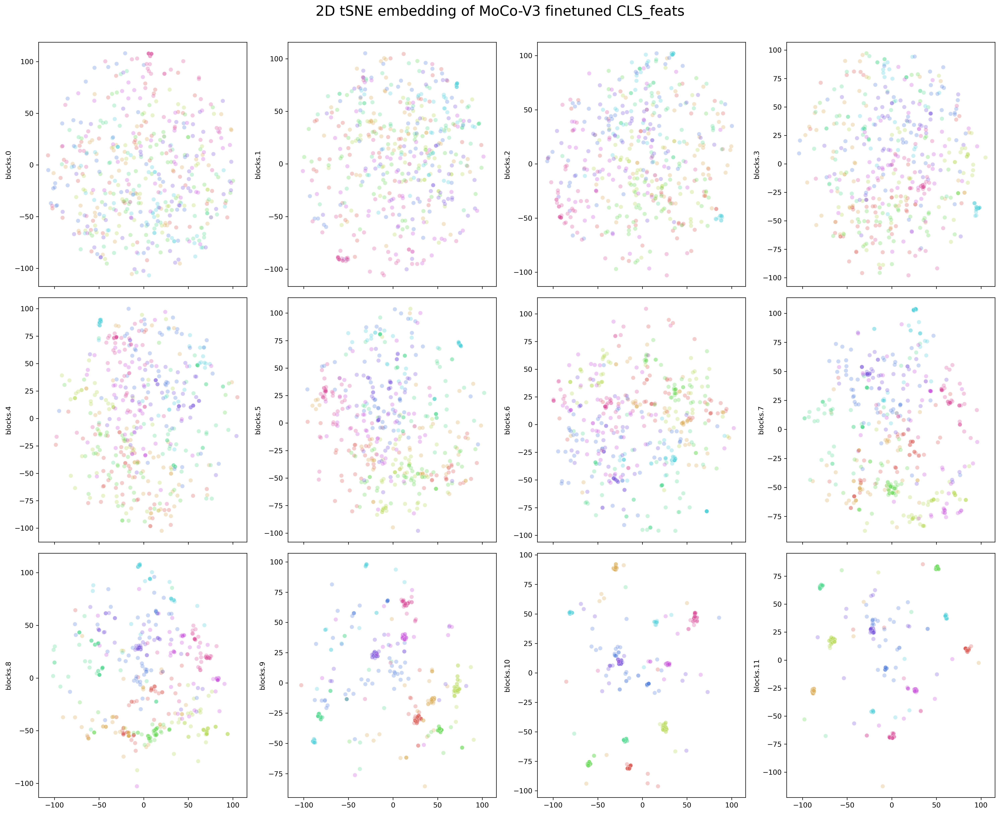

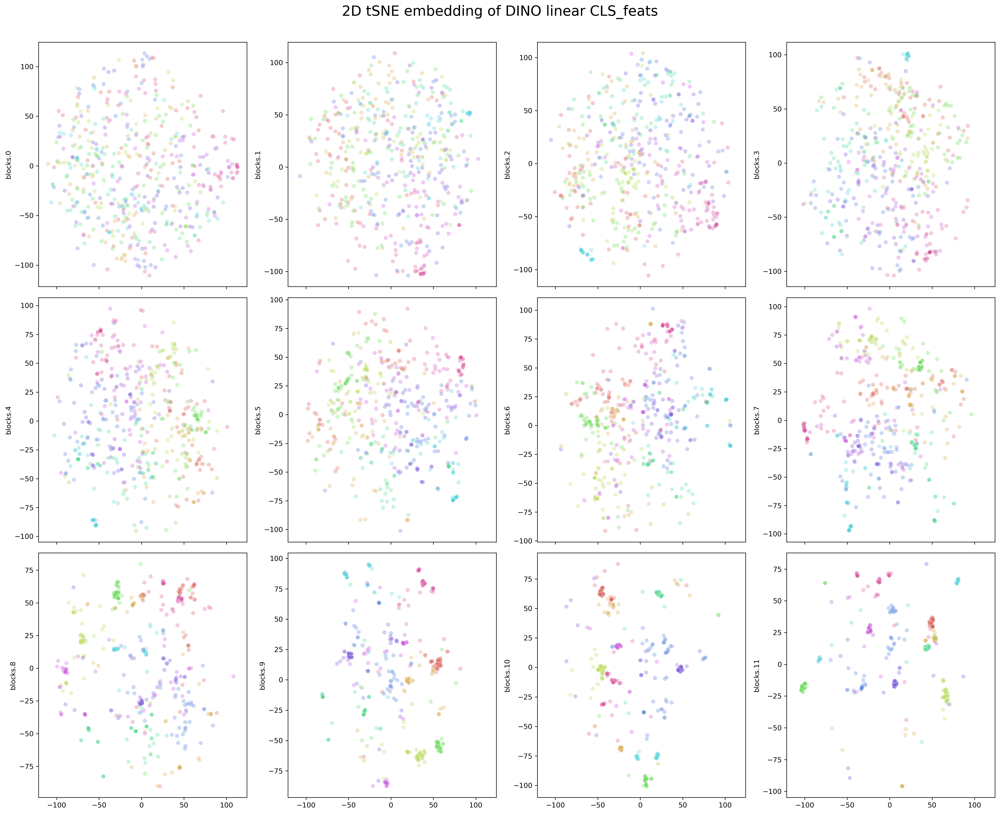

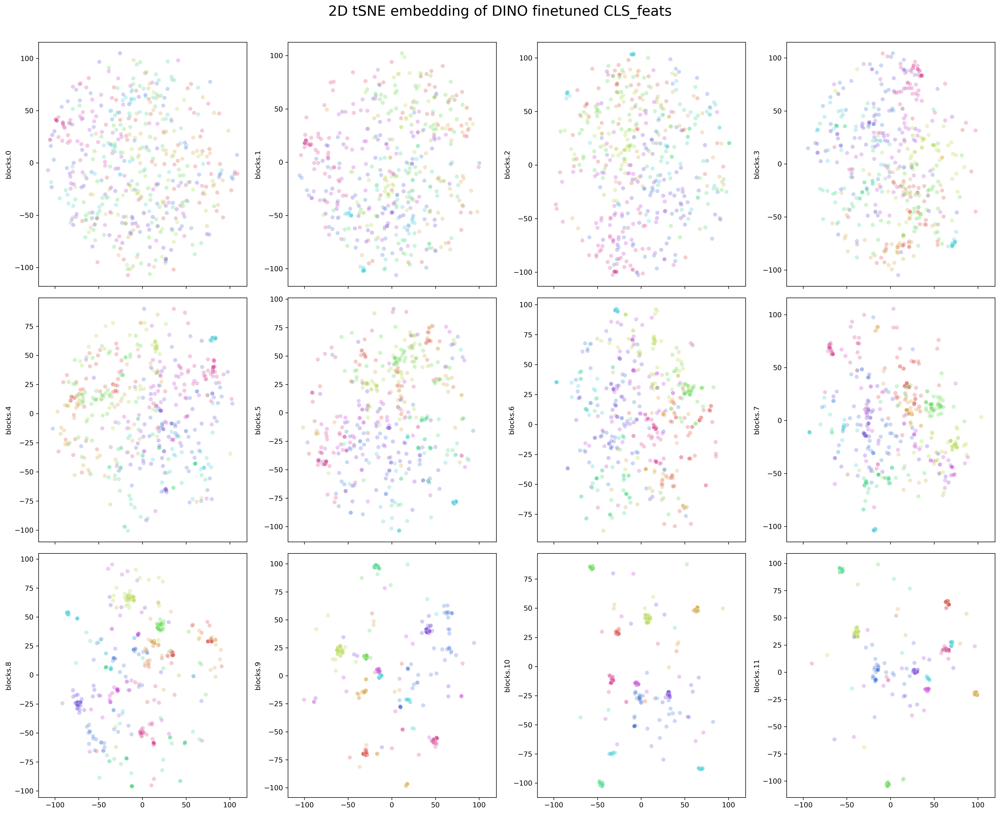

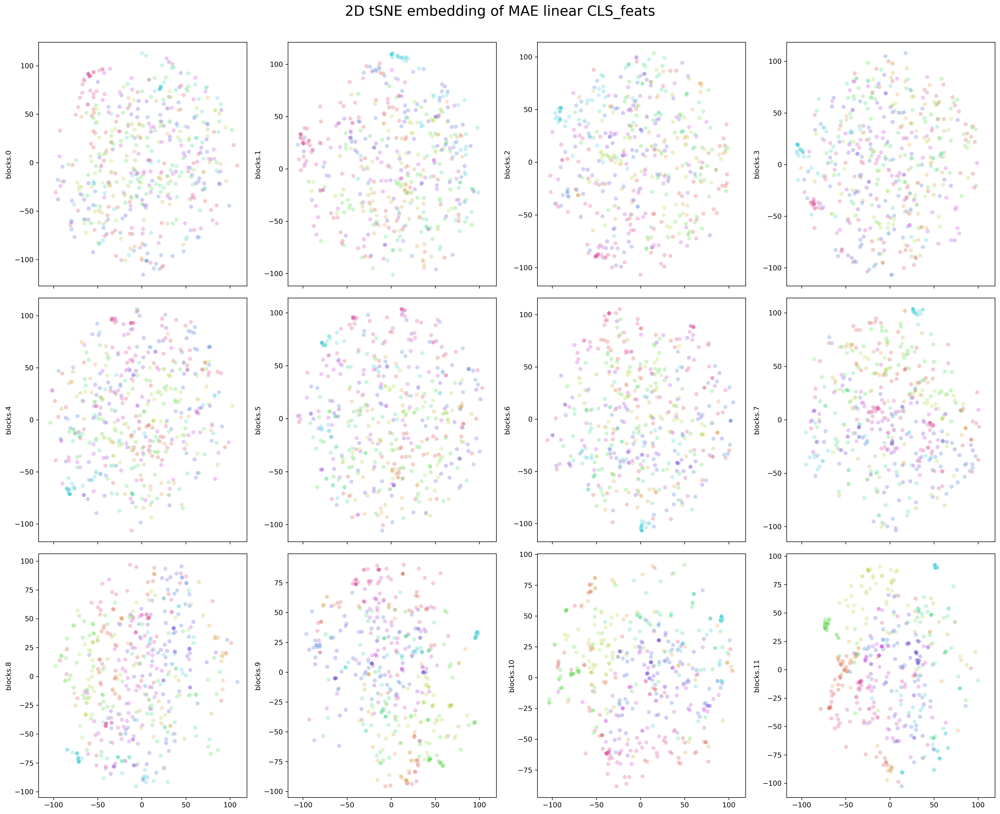

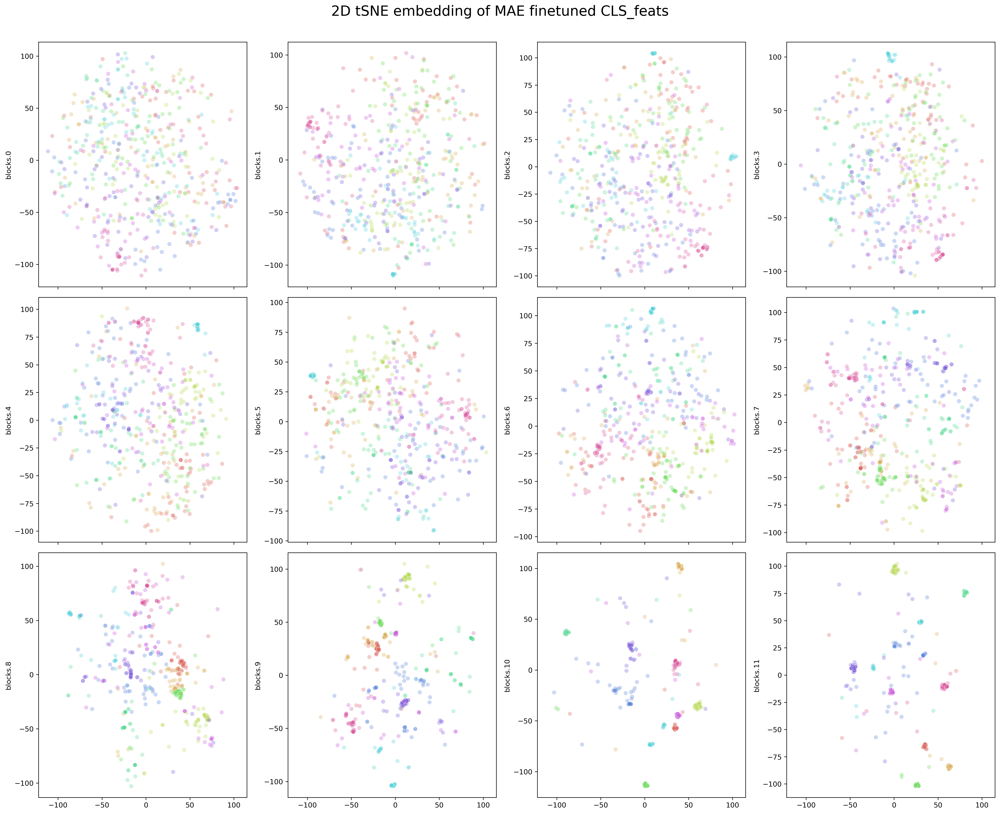

In [12]:
for name in names:
    for mode in modes:
        for agg in aggs:
            tSNE_plot_all_blocks(tsne_all_results, test_labels, name, mode, agg)